In [ ]:
#!pip install numpy pandas networkx matplotlib

In [ ]:
import os
import json
import numpy as np
import pandas as pd
import networkx as nx
from networkx.algorithms import community
import matplotlib.pyplot as plt
from typing import List, Optional
from datetime import datetime

#from google.colab import drive
#drive.mount('/content/drive')

Mounted at /content/drive


### Structure of dataset
A Social Network Analysis (SNA) was conducted on the dataset for the identification and analysis of relationships between entities within a network.
The dataset looks like:
```
[
  {
    "Title": string,
    "Number": string,
    "Category": string,
    "Author": string,
    "Date": date,
    "State": string,
    "Answered_by": string,
    "Body": string,
    "Upvotes": integer,
    "Labels": [
      "Profiles"
    ],
    "Participants": entire,
    "Answer_count": integer,
    "Reply_count": integer,
    "Answers": [
      {
        "IsOffTopic": boolean,
        "Author": string,
        "Date": date,
        "Body": string,
        "Upvotes": integer,
        "Accepted": boolean,
        "Reply_count": integer,
        "Replies": [
          {
            "Author": string,
            "Body": string,
            "Date": date,
            "IsAuthor": boolean,
            "Sentiment": "negative","neutral","positive"
          }
        ],
        "Sentiment": "negative","neutral","positive"
      }
    ],
    "Sentiment": "negative","neutral","positive"
  }
]
```

So defining the classes:

In [ ]:
class Reply:
    def __init__(self, Author: str, Body: str, Date: str, IsAuthor: bool, Sentiment: str):
        self.author = Author
        self.body = Body
        self.date = datetime.strptime(Date, "%Y-%m-%dT%H:%M:%SZ") if Date and Date != "{{datetime}}" else None
        self.is_author = IsAuthor
        self.sentiment = Sentiment

class Answer:
    def __init__(self, IsOffTopic: bool, Author: str, Date: str, Body: str, Upvotes: int, Accepted: bool, Reply_count: int, Replies: Optional[List[dict]], Sentiment: str):
        self.is_off_topic = IsOffTopic
        self.author = Author
        self.date = datetime.strptime(Date, "%Y-%m-%dT%H:%M:%SZ") if Date and Date != "{{datetime}}" else None
        self.body = Body
        self.upvotes = Upvotes
        self.accepted = Accepted
        self.reply_count = Reply_count
        self.replies = [Reply(**reply) for reply in Replies] if Replies else []
        self.sentiment = Sentiment

class Post:
    def __init__(self, Title: str, Number: str, Category: str, Author: str, Date: str, State: str, Answered_by: Optional[str], Body: str, Upvotes: int, Labels: Optional[List[str]], Participants: dict, Answer_count: int, Reply_count: int, Answers: List[Answer], Sentiment: str):
        self.title = Title
        self.number = Number
        self.category = Category
        self.author = Author
        self.date = datetime.strptime(Date, "%Y-%m-%dT%H:%M:%SZ") if Date and Date != "{{datetime}}" else None
        self.state = State
        self.answered_by = Answered_by
        self.body = Body
        self.upvotes = Upvotes
        self.labels = Labels
        self.participants = Participants
        self.answer_count = Answer_count
        self.reply_count = Reply_count
        self.answers = [Answer(**answer) for answer in Answers] if Answers else []
        self.sentiment = Sentiment


### Function Documentation
`readStackedJSONObject(path: str) -> list[dict]`

The function takes a file path as an argument and opens the specified file in read mode ('r'). It reads the file contents, closes the file, and returns a list of dictionaries obtained by decoding the stacked JSON objects in the file content if the path is correct. Otherwise, it raises a FileNotFoundError.

`decodeStackedJSONObjects(stacked_json_objects: str) -> list[dict]`

This function decodes a string containing stacked JSON objects and returns a list of the posts.

`getPostAuthors(posts) -> set()`

This function take a list of posts and return a set of all the authors of the posts.

`getAnswerAuthors(posts) -> set()`

This function take a list of posts and return a set of all the authors of the answer.

`getReplyAuthors(posts) -> set()`

This function take a list of posts and return a set of all the authors of the reply.

`splitterPostAuthors(posts) -> list, list, list, list`

The function takes the list of the posts as an argument and it returns four lists of posts:

* *postsWithAnswer*: All posts with post authors who have a posts with answers.
* *postsWithoutAnswer*: All posts with post authors who have a posts without answer.
* *postsWithAnswerHimSelf*: All posts with post authors who have replied to themselves and others have replied the answer.
* *postsWithAnswerHimSelfNoReply*: All posts with post authors who have replied to themselves and no ones have replied the answer.

`density(G: Graph)`

The function takes a graph G, calculates and return the density, defined as the ratio between the actual number of edges and the possible number of edges in the graph.

`getTopics(posts)`

The function takes the posts in input and return the list with the number of the topics citated in the posts.

`identifyAndVisualizeCommunities(G)`

The function has in input a graph and calculate all the communities with Garvin Newman and filtering with a community at least 2 users, at the end show the elaborated graph.

`showGraph(G)`

The function has in input a graph and showthe number of the nodes and the edges and plot the graph.

In [ ]:
def readStackedJSONObject(filePath):
    if os.path.exists(filePath):
      print("File path", filePath, "is right!")

      with open(filePath, 'r') as file:
        file_content = file.read()
      return decodeStackedJSONObjects(file_content)

    else:
      raise FileNotFoundError("File path {} wrong!".format(filePath))

def decodeStackedJSONObjects(stacked_json_objects: str) -> list[Post]:
    decoder = json.JSONDecoder()
    parsed_values = []
    pos = 0

    while stacked_json_objects:
      obj, pos = decoder.raw_decode(stacked_json_objects)
      stacked_json_objects = stacked_json_objects[pos:].strip()
      parsed_values.append(Post(**obj))
    return parsed_values

def getPostAuthors(posts):
    authors = set()
    for post in posts:
      authors.add(post.author)
    return authors

def getAnswerAuthors(posts):
    answerAuthors = set()
    for post in posts:
        for answer in post.answers:
            answerAuthors.add(answer.author)
    return answerAuthors

def getReplyAuthors(posts):
    replyAuthors = set()
    for post in posts:
        for answer in post.answers:
            if answer.replies:
                for reply in answer.replies:
                    replyAuthors.add(reply.author)

    return replyAuthors

def splitterPostAuthors(posts):
    postsWithAnswer = []
    postsWithoutAnswer = []
    postsWithAnswerHimSelf = []
    postsWithAnswerHimSelfNoReply = []

    for post in posts:
        # Check if the post has answers
        if len(post.answers) == 0:
            postsWithoutAnswer.append(post)
        elif len(post.answers) > 0:
            # Check if the author has answered to themselves
            authorAnsweredHimSelf = any(answer.author == post.author for answer in post.answers)

            # Check if there are replies
            answerReplies = any(answer.replies for answer in post.answers)

            if (len(post.answers) == 1 and authorAnsweredHimSelf and answerReplies):
                postsWithAnswerHimSelf.append(post)
            elif (len(post.answers) == 1 and authorAnsweredHimSelf and not answerReplies):
                postsWithAnswerHimSelfNoReply.append(post)
            else:
                postsWithAnswer.append(post)

    print("Posts with answers:", len(postsWithAnswer))
    print("Posts without answers:", len(postsWithoutAnswer))
    print("Posts with one answer and have answered by the author and others have replied:", len(postsWithAnswerHimSelf))
    print("Posts with one answer and have answered by the author and no one has replied:", len(postsWithAnswerHimSelfNoReply))

    return postsWithAnswer, postsWithoutAnswer, postsWithAnswerHimSelf, postsWithAnswerHimSelfNoReply

def density(G):
    nEdges = G.number_of_edges()
    nNodes = G.number_of_nodes()
    density = 2 * nEdges / (nNodes * (nNodes - 1))

    return density

def getTopics(posts):
    topicCounts = {}
    for post in posts:
      category = post.category
      topicCounts[category] = topicCounts.get(category, 0) + 1

    return topicCounts

def identifyAndVisualizeCommunities(G):
    # Identify interaction subgroups
    graphCopy = nx.DiGraph(G)
    communitiesGenerator = community.girvan_newman(graphCopy)
    topLevelCommunities = next(communitiesGenerator)
    nextLevelCommunities = next(communitiesGenerator)

    print("Interaction Subgroups:")
    for i, communities in enumerate(nextLevelCommunities):
      # Community with more 1 user
        if len(communities) > 1:
            print(f"Community {i + 1}: {communities}")

    pos = nx.spring_layout(G)
    colors = [0] * G.number_of_nodes()

    for i, communities in enumerate(nextLevelCommunities):
        for node in communities:
            colors[list(G.nodes).index(node)] = i + 1

    fig, ax = plt.subplots(figsize=(40, 40))
    nx.draw(G, pos, with_labels=True, font_size=8, node_size=500, node_color=colors, cmap="tab20", font_color="black", edge_color="gray", linewidths=0.5, ax=ax)
    plt.show()

def showGraph(G):
    print('Nodes:', len(G.nodes))
    print('Edges:', len(G.edges))

    # Graph visualization
    pos = nx.spring_layout(G)
    fig, ax = plt.subplots(figsize=(40, 40))
    nx.draw(G, pos, with_labels=True, font_size=8, node_size=500, node_color="skyblue", font_color="black", edge_color="gray", linewidths=0.5, ax=ax)
    plt.show()

In [ ]:
filePath = '/data/gh_discussions_badges.json'

posts = readStackedJSONObject(filePath)

File path /content/drive/MyDrive/Colab Notebooks/gh_discussions_badges.json is right!


## Consideration
Before the Social Network Analysis (SNA) starts, is important to taking into consideration various aspects:
*  *Removal of unanswered questions*: Unanswered questions have been eliminated to focus exclusively on **active interactions**, in order to focus attention on more dynamic contexts.
*  *Exclusion of posts in which the author responded to himself without receiving other replies*: to ensure greater precision in interactions, posts in which the author responded to himself without receiving any external comments were excluded.
* *Graph simplification*: Removing nodes corresponding to unanswered questions could simplify the graph structure. This process aims to make it easier to identify patterns and communities among active users, thus facilitating the understanding of social dynamics within the platform.

To conduct an interaction analysis, the dataset was divided into four distinctive categories:
*   Users who asked a question and received an answer.
*   Users who asked a question but doesn't received an answer.
*   Users who asked a question and they answered themselves and received a reply on the answer.
*   Users who asked a question and they answered themselves and doesn't received a reply on the answer.

After that, some analytical and statistical calculation about the posts, the users and the topics.

In [ ]:
print("Total posts:", len(posts))
postsWithAnswer, postsWithoutAnswer, postsWithAnswerHimSelf, postsWithAnswerHimSelfNoReply = splitterPostAuthors(posts)

# Analysis of all the Users
allUsers = set()

allUsers.update(getPostAuthors(postsWithAnswer), getAnswerAuthors(postsWithAnswer), getReplyAuthors(postsWithAnswer))

print("\nAll authors:", len(allUsers))
print("All post authors:",len(getPostAuthors(postsWithAnswer)))
print("All answer authors:",len(getAnswerAuthors(postsWithAnswer)))
print("All reply authors:",len(getReplyAuthors(postsWithAnswer)))

countAnswered = 0
# Really answerd posts
for post in postsWithAnswer:
    if post.state == "Answered":
        countAnswered += 1

print("\nPost with the really right answer:", (countAnswered/len(postsWithAnswer))* 100)

# Intersections between sets
postAndAnswerUsers = getPostAuthors(postsWithAnswer).intersection(getAnswerAuthors(postsWithAnswer))
postAndReplyUsers = getPostAuthors(postsWithAnswer).intersection(getReplyAuthors(postsWithAnswer))
answerAndReplyUsers = getAnswerAuthors(postsWithAnswer).intersection(getReplyAuthors(postsWithAnswer))
postAndAnswerAndReplyUsers = postAndAnswerUsers.intersection(postAndReplyUsers.intersection(answerAndReplyUsers))

print("\nIntersections between sets:")
print("Users who wrote both posts and answers:", len(postAndAnswerUsers))
print("Users who wrote both posts and replies:", len(postAndReplyUsers))
print("Users who wrote both answers and replies:", len(answerAndReplyUsers))
print("Users who wrote all (post, answer and reply):", len(postAndAnswerAndReplyUsers))

usersNeverAsked = getPostAuthors(postsWithoutAnswer).intersection(getPostAuthors(postsWithAnswer))
print("Unanswered post users who have never had a response to a post:", len(usersNeverAsked))

# Percentages relative to the total
totalAuthors = len(allUsers)

percentagePostAuthors = (len(getPostAuthors(postsWithAnswer)) / totalAuthors) * 100
percentageAnswerAuthors = (len(getAnswerAuthors(postsWithAnswer)) / totalAuthors) * 100
percentageReplyAuthors = (len(getReplyAuthors(postsWithAnswer)) / totalAuthors) * 100

print("\nPercentages relative to the total:")
print("Percentage of post users:", percentagePostAuthors)
print("Percentage of answer users:", percentageAnswerAuthors)
print("Percentage of reply users:", percentageReplyAuthors)

print("\nTopics in all the posts:")
for topic, count in getTopics(posts).items():
    print(topic, ":", count)

print("\nTopics in the posts with answer:")
for topic, count in getTopics(postsWithAnswer).items():
    print(topic, ":", count)

print("\nTopics in the posts without any answer:")
for topic, count in getTopics(postsWithoutAnswer).items():
    print(topic, ":", count)

Total posts: 312
Posts with answers: 288
Posts without answers: 18
Posts with one answer and have answered by the author and others have replied: 2
Posts with one answer and have answered by the author and no one has replied: 4

All authors: 1006
All post authors: 277
All answer authors: 555
All reply authors: 488

Post with the really right answer: 50.69444444444444

Intersections between sets:
Users who wrote both posts and answers: 63
Users who wrote both posts and replies: 126
Users who wrote both answers and replies: 167
Users who wrote all (post, answer and reply): 42
Unanswered post users who have never had a response to a post: 0

Percentages relative to the total:
Percentage of post users: 27.534791252485093
Percentage of answer users: 55.16898608349901
Percentage of reply users: 48.508946322067594

Topics in all the posts:
Profile : 308
Actions and Packages : 2
New to GitHub : 1
Discover : 1

Topics in the posts with answer:
Profile : 286
New to GitHub : 1
Discover : 1

Topic

#### Temporal analysis

Consequently, *temporal analysis* was conducted to obtain a detailed view of the progress of the activity regarding publications, responses and comments, divided by months.

Day with the maximum number of posts: 2022-06-30 00:00:00 Number of posts: 132
Day with the maximum number of answers: 2022-06-30 00:00:00 Number of answers: 404
Day with the maximum number of replies: 2022-06-30 00:00:00 Number of replies: 261


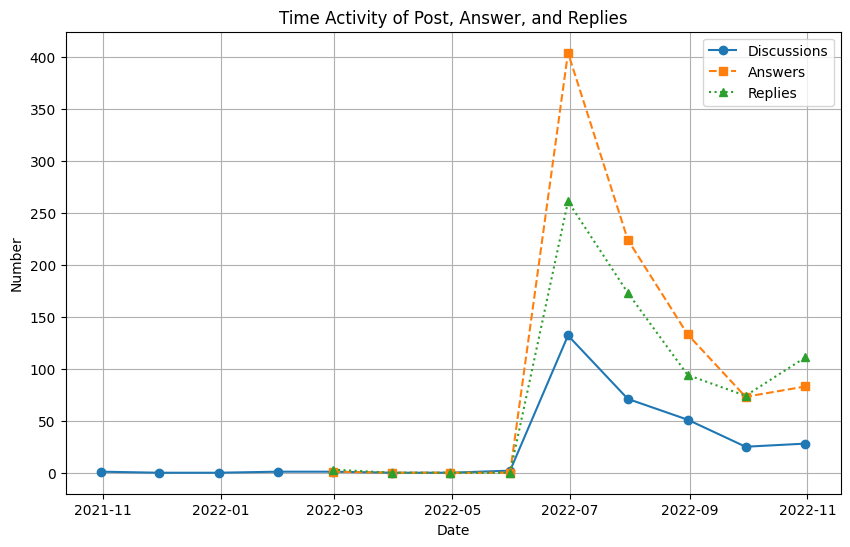

In [ ]:
# Take the valid dates from the posts
datesPosts = [post.date for post in posts if post.date is not None]
datesAnswers = [answer.date for post in posts for answer in post.answers if answer.date is not None]
datesReplies = [reply.date for post in posts for answer in post.answers for reply in answer.replies if reply.date is not None]

# Sort the dates
sortedDatesPosts = sorted(datesPosts)
sortedDatesAnswers = sorted(datesAnswers)
sortedDatesReplies = sorted(datesReplies)

# Create DataFrames from the sorted dates and set the 'Date' column as the index
dfPosts = pd.DataFrame({'Date': sortedDatesPosts})
dfPosts.set_index('Date', inplace=True)

dfAnswers = pd.DataFrame({'Date': sortedDatesAnswers})
dfAnswers.set_index('Date', inplace=True)

dfReplies = pd.DataFrame({'Date': sortedDatesReplies})
dfReplies.set_index('Date', inplace=True)

# Group data by period
dfPostsResampled = dfPosts.resample('M').size()
dfAnswersResampled = dfAnswers.resample('M').size()
dfRepliesResampled = dfReplies.resample('M').size()

# Find the day with the maximum number of posts, answers, and replies
print("Day with the maximum number of posts:", dfPostsResampled.idxmax(), "Number of posts:", dfPostsResampled.max())
print("Day with the maximum number of answers:", dfAnswersResampled.idxmax(), "Number of answers:", dfAnswersResampled.max())
print("Day with the maximum number of replies:", dfRepliesResampled.idxmax(), "Number of replies:", dfRepliesResampled.max())

# Create a time graph
plt.figure(figsize=(10, 6))

# Posts graph
plt.plot(dfPostsResampled.index, dfPostsResampled.values, label='Discussions', marker='o', linestyle='-')

# Answers graph
plt.plot(dfAnswersResampled.index, dfAnswersResampled.values, label='Answers', marker='s', linestyle='--')

# Replies graph
plt.plot(dfRepliesResampled.index, dfRepliesResampled.values, label='Replies', marker='^', linestyle=':')

plt.title('Time Activity of Post, Answer, and Replies')
plt.xlabel('Date')
plt.ylabel('Number')
plt.legend()
plt.grid(True)
plt.show()

 It is interesting to note how, at the end of June, there was a marked **growth** in activity, followed by a **progressive decline** in the following months.

### Graphs

**Two directed graphs** are generated to visualize the interactions between the users within the platform:

*   A graph of interactions between Post Authors and Reply Authors:
    *   This graph highlights the interactions between the users of the post and the people who answered to the post:
        *   Nodes represent both post users and reply users.
        *   Arcs connect reply users to post users and show interactions between them.

*   A graph of interactions between Authors of Answers and Those Who Replied to These Answers:
    *   This graph highlights the interactions between the users of the replies to the posts and the people who commented on those replies:
        *   Nodes represent the users of the answer and the users that reply.
        *   Arcs indicate connections the repliers and the answerers.

To further understand the structure of networks, several properties of the graph were analyzed, including:
*   **In-Degree centrality**
*   **Out-Degree centrality**.
*   **Density**
*   **Giant component**
*   **Community** (with Girvan Newman algorithm)

#### First graph:

Nodes: 769
Edges: 887


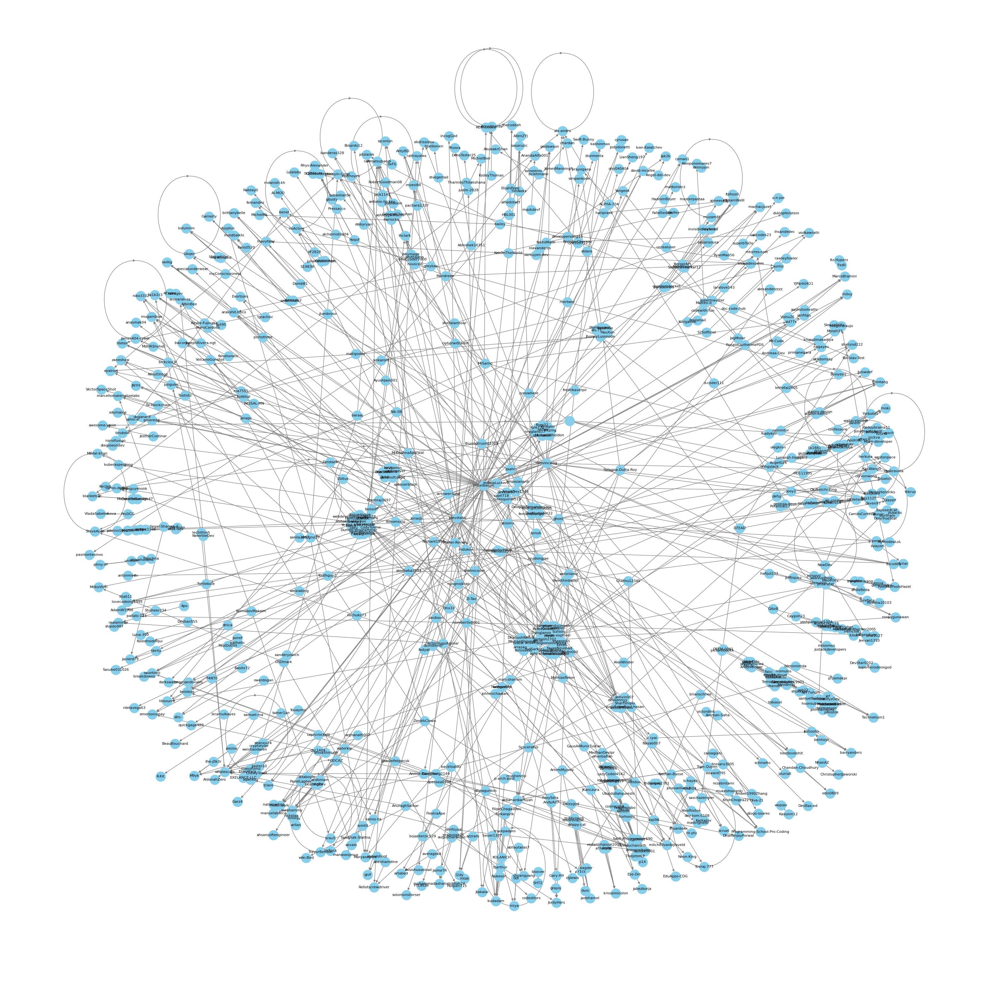

In [ ]:
# Create a graph
# Graph --> undirect, DiGraph --> direct
G = nx.DiGraph()

# Add nodes and edges to the graph
for post in postsWithAnswer:
    postAuthor = post.author

    # Add node for the post author
    G.add_node(postAuthor)

    # Add arcs between the post author and the answer authors
    for answer in post.answers:
        answerAuthor = answer.author

        # Add node for the answer author
        G.add_node(answerAuthor)

        # Add directed edge from answer author to post author
        G.add_edge(answerAuthor, postAuthor)

showGraph(G)

#### In-degree and Out-Degree Centrality and Density

In [ ]:
print("In-degree centrality:")
inDc = nx.in_degree_centrality(G)
inDcSorted = {k: v for k, v in sorted(
    inDc.items(),
    key=lambda item: item[1],
    reverse=True
)}

for node, centrality in inDcSorted.items():
  if(centrality > 0.01):
    print(node, ":", centrality)

print("\nOut-degree centrality:")
outDc = nx.out_degree_centrality(G)
outDcSorted = {k: v for k, v in sorted(
    outDc.items(),
    key=lambda item: item[1],
    reverse=True
)}

for node, centrality in outDcSorted.items():
  # Let's take centrality > 0.005
  if(centrality > 0.005):
    print(node, ":", centrality)

# Hubs and authorities (let's take the first five)
authorities = sorted(
    G.in_degree,
    key=lambda x: x[1],
    reverse=True
)[:5]

hubs = sorted(
    G.out_degree,
    key=lambda x: x[1],
    reverse=True
)[:5]

print('\nAuthorities:', authorities)
print('Hubs:', hubs)

# Displaying the density of the graph
print("\nGraph Density:", density(G))

In-degree centrality:
deeperwhales : 0.0390625
wavescats : 0.03645833333333333
nickva : 0.029947916666666664
rossjrw : 0.028645833333333332
lars1125 : 0.01953125
lodgendury : 0.01953125
rilysh : 0.016927083333333332
whalescats : 0.016927083333333332
SteveALee : 0.015625
devkennyy : 0.015625
andae : 0.015625
BogomolovNikita : 0.014322916666666666
rahmatsubandi : 0.014322916666666666
kudadam : 0.014322916666666666
byronbytes : 0.013020833333333332
mattrighetti : 0.013020833333333332
queenofcorgis : 0.01171875
scarnation : 0.01171875
WilliamWelll : 0.010416666666666666
wwahammy : 0.010416666666666666
GoldenMaximo : 0.010416666666666666
Programming-School-Pro-Coding : 0.010416666666666666
fynntang : 0.010416666666666666

Out-degree centrality:
linuxlawson : 0.07161458333333333
jdevstatic : 0.046875
melvincwng : 0.04036458333333333
wavescats : 0.009114583333333332
aaronlamz : 0.009114583333333332
ale-lit : 0.009114583333333332
 : 0.009114583333333332
airtower-luna : 0.0078125
rodukov : 0.00

#### Connected components
Calculate the connected components
*   connected_components --> For undirected graphs only.
*   weakly_connected_components --> For directed graphs only, considering the edges as non-directional.
*   strongly_connected_components --> For directed graphs only, considering the direction of the edges.

Nodes: 668
Edges: 827


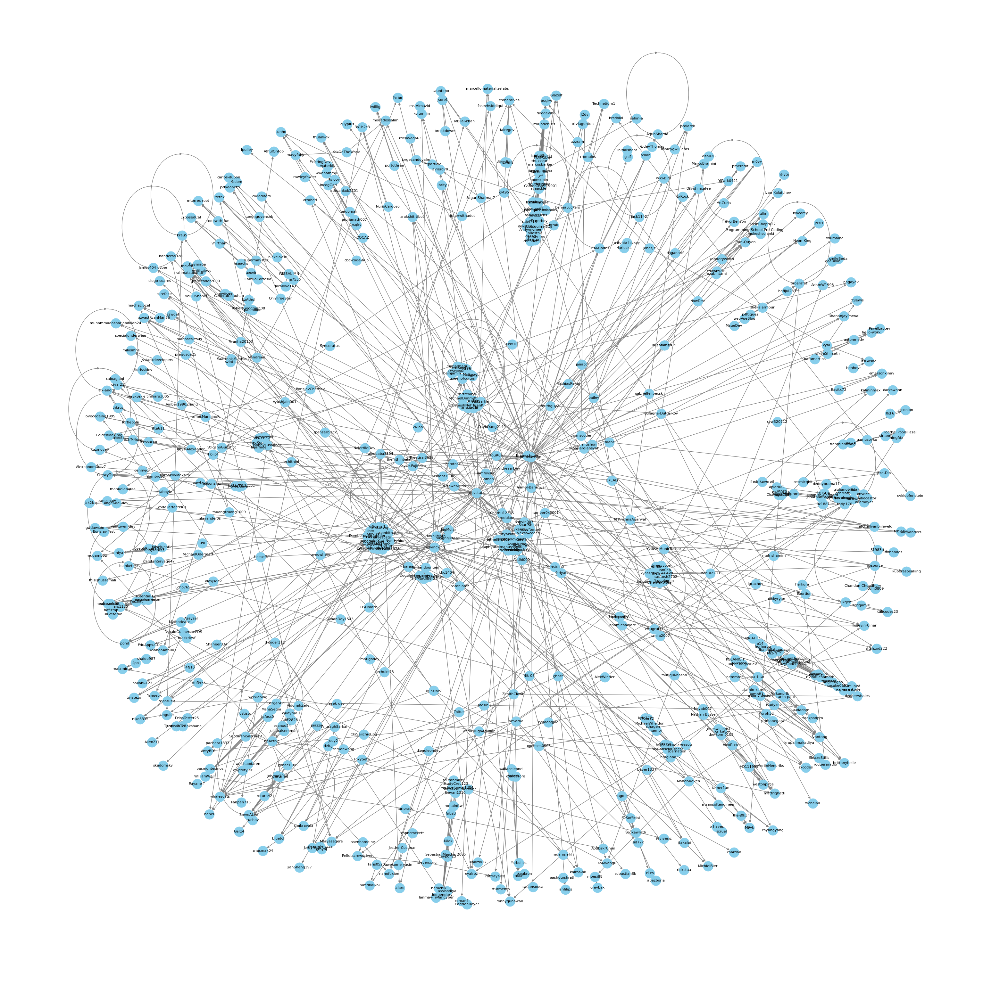

In [ ]:
components = list(nx.weakly_connected_components(G))

# Find the giant component
giantComponent = max(components, key=len)

# Extract the subgraph corresponding to the giant component
giantSubgraph = G.subgraph(giantComponent)

showGraph(giantSubgraph)

#### Communities

Interaction Subgroups:
Community 1: {'', 'ItsGosho', 'seviyesiz', 'Technetium1', 'sheilalarmour', 'ertugrul37', 'sasuke0601', 'rezabintami', 'aleksa-codes', 'Youaymo', 'Sulagna-Dutta-Roy', 'MaueDev', 'wiki-Bird', 'DumbergerL', 'Azayzel', 'ApidriuC', 'shahzod222', 'AlexWinder', 'benhoyt', 'KodeyThomas', 'manasesjesus', 'brianschnee', 'cervonwong', 'MitkoVtori', 'gljusty', 'AbubakrChan', 'Binardo12', 'VolcanoGunshot', 'F4NT0', 'Okami0xff666', 'rivinduchamath', 'milosmns', 'vsoch', 'rilysh', 'CarstenSavage47', 'DhananjayPorwal', 'webVueBlog', 'alanny-design', 'alexanderzzzz', 'deeperwhales', 'webdeveloper12345678', 'opensea0508', 'rajel718', 'cosmicqbit', 'rromulos', 'Tran-Quyen', 'Potential17', 'miya', 'mdanish-kh', 'Saarthak-Slathia', 'HadrienBoyer', 'fertrevino', 'TheJeterLP', 'kevoj', 'ArnabDey1543', 'Matteo-it', 'itta611', 'brsdolol', 'mavyfaby', 'vishakh-abhayan', 'banderas328', 'grayoj', 'masonzmz', 'TrungJamin', 'ctjlewis', 'ma7555', 'TharinduThilakshana', 'specialunderwear', 'awe

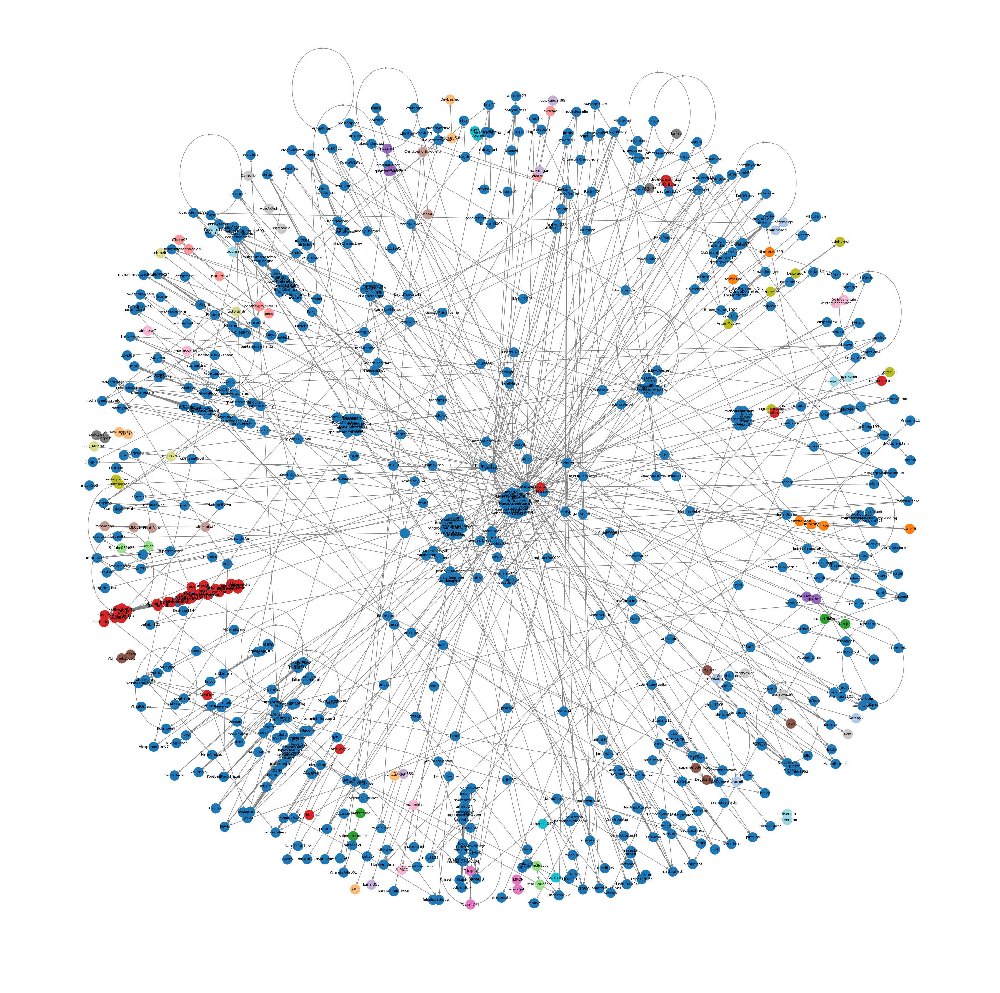

In [ ]:
identifyAndVisualizeCommunities(G)

#### Second graph:

Nodes: 875
Edges: 672


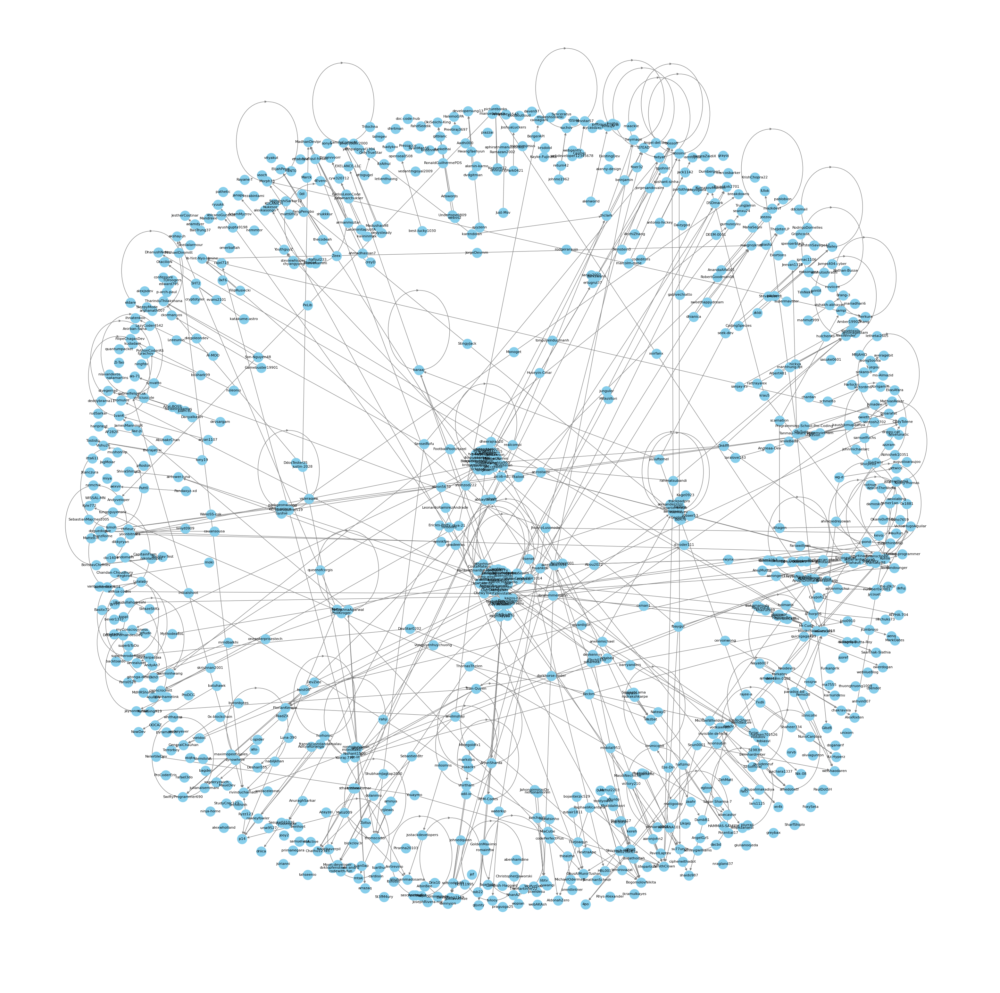

In [ ]:
# Creation of the directed graph answerAuthors and replies
H = nx.DiGraph()

# Add nodes and edges to the graph
for post in postsWithAnswer:
    # Add arcs between the answer author and the replies authors
    for answer in post.answers:
        if answer.author:
            answerAuthor = answer.author
            H.add_node(answerAuthor)

            for reply in answer.replies:
                replyAuthor = reply.author
                H.add_node(replyAuthor)

                # Add directed edge from replies author to answer author
                H.add_edge(replyAuthor, answerAuthor)

showGraph(H)

#### In-degree and Out-Degree Centrality and Density

In [ ]:
print("In-degree centrality: (the highest value is the authority)")
inDc = nx.in_degree_centrality(H)
inDcSorted = {k: v for k, v in sorted(
    inDc.items(),
    key=lambda item: item[1],
    reverse=True
)}

for node, centrality in inDcSorted.items():
  if(centrality > 0.01):
    print(node, ":", centrality)

print("\nOut-degree centrality: (the highest value is the hubs)")
outDc = nx.out_degree_centrality(H)
outDcSorted = {k: v for k, v in sorted(
    outDc.items(),
    key=lambda item: item[1],
    reverse=True
)}

for node, centrality in outDcSorted.items():
  if(centrality > 0.005):
    print(node, ":", centrality)

# Hubs and authorities (let's take the first five)
authorities = sorted(
    H.in_degree,
    key=lambda x: x[1],
    reverse=True
)[:5]

hubs = sorted(
    H.out_degree,
    key=lambda x: x[1],
    reverse=True
)[:5]

print('\nAuthorities:', authorities)
print('Hubs:', hubs)

# Displaying the density of the graph
print("\nGraph Density:", density(H))

In-degree centrality: (the highest value is the authority)
melvincwng : 0.04004576659038902
linuxlawson : 0.027459954233409613
wavescats : 0.019450800915331808
jdevstatic : 0.017162471395881007
ZenithClown : 0.012585812356979404
brianschnee : 0.011441647597254004
ale-lit : 0.011441647597254004
akbar-ardiansyah : 0.010297482837528604
rodukov : 0.010297482837528604

Out-degree centrality: (the highest value is the hubs)
aleebaba3594 : 0.013729977116704806
jdevstatic : 0.011441647597254004
linuxlawson : 0.008009153318077803
melvincwng : 0.006864988558352403
JhonnyLusonode : 0.005720823798627002
MrKrishnaAgarwal : 0.005720823798627002
ThomasThelen : 0.005720823798627002
Karkatov : 0.005720823798627002

Authorities: [('melvincwng', 35), ('linuxlawson', 24), ('wavescats', 17), ('jdevstatic', 15), ('ZenithClown', 11)]
Hubs: [('aleebaba3594', 12), ('jdevstatic', 10), ('linuxlawson', 7), ('melvincwng', 6), ('JhonnyLusonode', 5)]

Graph Density: 0.001757437070938215


#### Connected components

Nodes: 380
Edges: 475


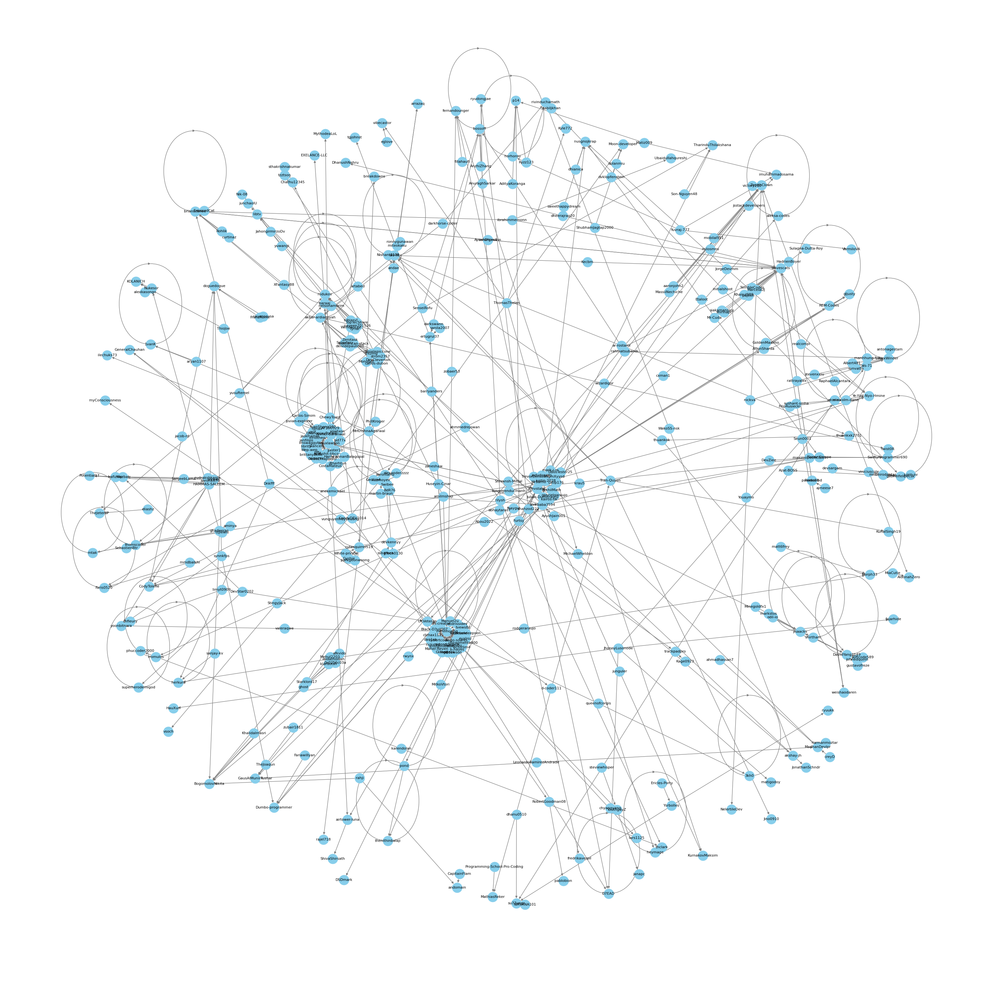

In [ ]:
components = list(nx.weakly_connected_components(H))

# Find the giant component
giantComponent = max(components, key=len)

# Extract the subgraph corresponding to the giant component
giantSubgraph = H.subgraph(giantComponent)

showGraph(giantSubgraph)

#### Communities

Interaction Subgroups:
Community 1: {'aarongeo1', 'doguedogue', 'burhancan-stack', 'mtak', 'shirinapr', 'viniciuscole', 'Wazbat', 'imuhammadosama', 'Matiz009', 'rodgeraraujo', 'SanjeebLama', 'ertugrul37', 'HauXun', 'maximopeoficiales', 'matt6frey', 'dan1xk', 'cybertcode', 'mribeirodantas', 'superherodemigod', 'Youaymo', 'Sulagna-Dutta-Roy', 'Guedesou', 'MiaCutie', 'Yuvraj-777', 'DhanushNehru', 'TheJoaqun', 'siakamansaly', 'curtinaz', 'MarcelaDJ', 'wizardigor', 'victorlim4', 'Turtlebole', 'akshay-jh', 'shahzod222', 'horhorou', 'AlexWinder', 'diogo-soares', 'brianschnee', 'WakoSS-nsk', 'SenseiRofu', 'dhianica', 'deividepaulino1', 'Nukesor', 'sthakrishnakumar', 'amilmshaji', 'AyushJain001', 'BogomolovNikita', 'Manuel2u', 'MassiiNechiche', 'fajarhide', 'XFantasy88', 'rivinduchamath', 'AyushDhimann', 'steviewhisper', 'milosmns', 'abhaytaras7', 'rahji', 'nelsonamorim', 'YouthguyZ', 'Ubaidullahqureshi', 'rilysh', 'queenofcorgis', 'Shivansh-Mittal', 'justin-2028', 'sanila2007', 'Morph33', 'aar

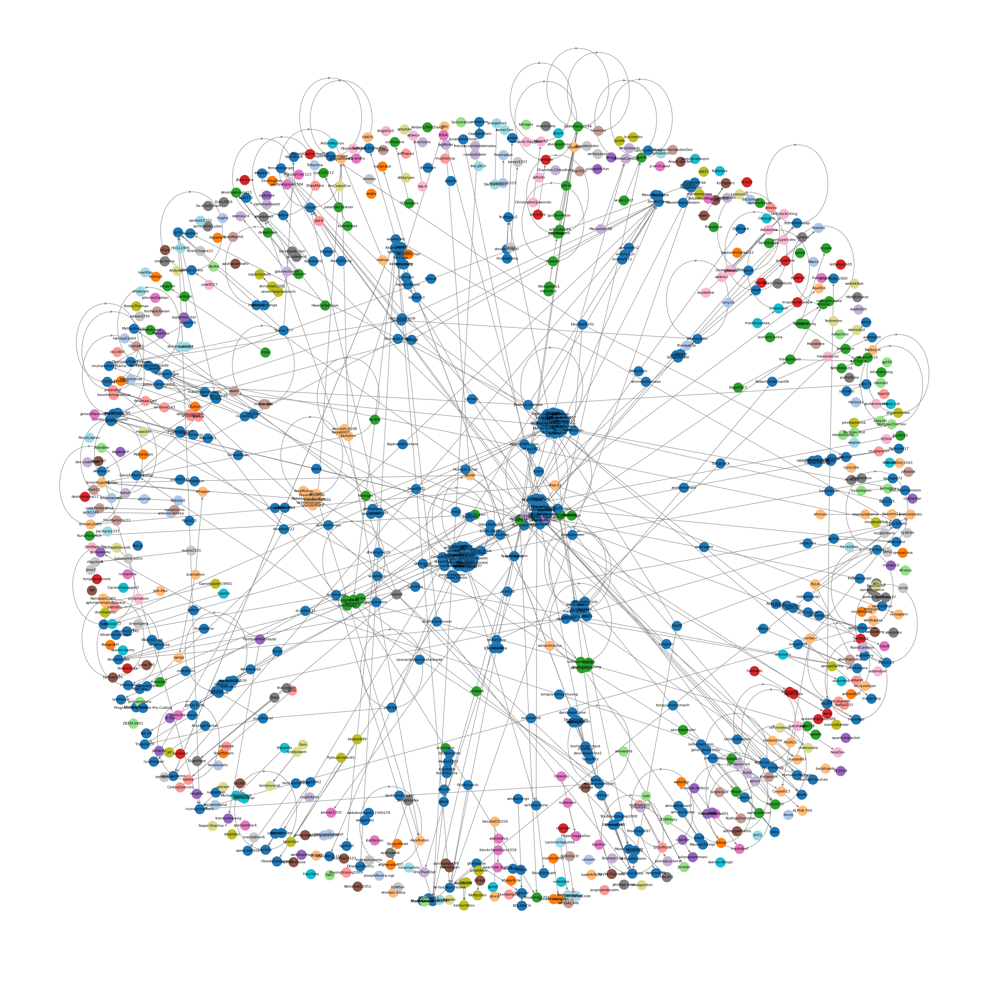

In [ ]:
identifyAndVisualizeCommunities(H)

### Sentiment analysis

In the following phase, an *analysis of the sentiments* associated with the individual posts was done. An analysis of the distribution of sentiment across posts was performed.

Furthermore, the calculation of the average sentiment for each author was carried out, considering the set of posts published by each author and found the author that pubblished the highest number of the post.

An important analysis is given by comparing the sentiment of the post and the average sentiment of the replies.

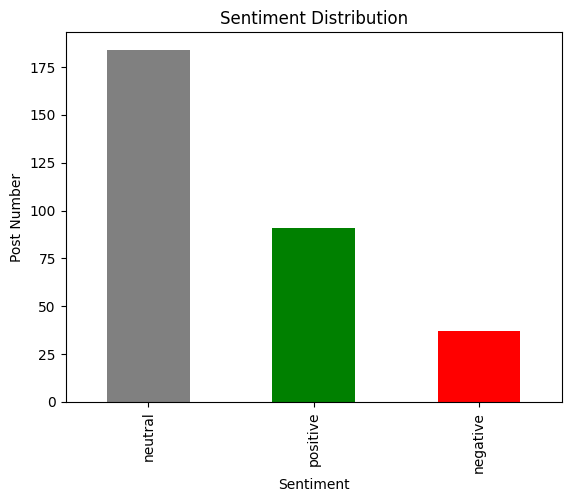

In [ ]:
# Create a DataFrame
df = {'Sentiment': [], 'Count': []}

# Count the number of posts for each sentiment
for post in posts:
    sentiment = post.sentiment.lower()
    df['Sentiment'].append(sentiment)
    df['Count'].append(1)

df = pd.DataFrame(df)

# Group by sentiment and sum the counts
sentimentDistribution = df['Sentiment'].value_counts()

# Plot the bar chart with specified colors
sentimentDistribution.plot(kind='bar', color=['gray', 'green', 'red'])
plt.title('Sentiment Distribution')
plt.xlabel('Sentiment')
plt.ylabel('Post Number')
plt.show()

In [ ]:
# DataFrame with post counts and sentiment totals for each author
df = pd.DataFrame(columns=['Number of posts', 'Sentiment'])

sentimentMapping = {'negative': -1, 'neutral': 0, 'positive': 1}

for post in posts:
    author = post.author
    sentiment = post.sentiment.lower()

    # Map sentiment values to -1, 0, 1
    sentimentValue = sentimentMapping.get(sentiment, 0)

    # Update author statistics in the DataFrame
    if author not in df.index:
        df.loc[author] = {'Number of posts': 0, 'Sentiment': 0}

    df.at[author, 'Number of posts'] += 1
    df.at[author, 'Sentiment'] += sentimentValue

# Calculate the average sentiment for each author
df['Average sentiment'] = df['Sentiment'] / df['Number of posts']

# Sort the DataFrame by post count in descending order
df = df.sort_values(by='Number of posts', ascending=False)

print(df[['Number of posts', 'Average sentiment']])

                    Number of posts  Average sentiment
devkennyy                         4               0.25
lars1125                          2               0.50
M9yk                              2               0.00
VolcanoGunshot                    2               0.00
gwdawson                          2               0.50
...                             ...                ...
MitkoVtori                        1              -1.00
FootballPoolsHazel                1               1.00
noActive                          1               1.00
pmeredit                          1              -1.00
hello-work                        1               0.00

[301 rows x 2 columns]


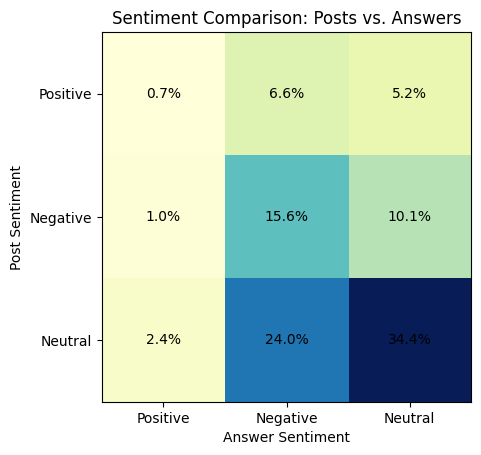

In [ ]:
correlatedSentiment = {'Post': [], 'Answers': []}

for post in postsWithAnswer:
     # Check if the sentiment of the post is "negative", "neutral" or "positive"
     if (post.sentiment == "negative" or post.sentiment == "neutral" or post.sentiment == "positive"):

         # Map sentiment values to -1, 0, 1
         correlatedSentiment['Post'].append(sentimentMapping.get(post.sentiment.lower(), 0))
         answerSentiment = 0
         num_valid_answers = 0

         for answer in post.answers:
             if (answer.sentiment == "negative" or answer.sentiment == "neutral" or answer.sentiment == "positive"):

                 answerSentiment += sentimentMapping.get(answer.sentiment.lower(), 0)
                 num_valid_answers += 1

         # Calculate the average sentiment of the responses
         averageAnswerSentiment = answerSentiment / num_valid_answers if num_valid_answers else 0

         correlatedSentiment['Answers'].append(averageAnswerSentiment)

# Contingency Matrix
contingencyMatrix = np.zeros((3, 3))

for postSentiment, answerSentiment in zip(correlatedSentiment['Post'], correlatedSentiment['Answers']):
    postIndex = 1 if postSentiment > 0 else 0 if postSentiment < 0 else 2
    answerIndex = 1 if answerSentiment > 0 else 0 if answerSentiment < 0 else 2

    contingencyMatrix[postIndex, answerIndex] += 1

# Calculation of percentages
totalPosts = len(correlatedSentiment['Post'])
percentages = (contingencyMatrix / totalPosts) * 100

# Defining the row and columns
labels = ['Positive', 'Negative', 'Neutral']

# Creation of the pie chart
fig, ax = plt.subplots()
im = ax.imshow(percentages, cmap="YlGnBu")

# Adding labels
ax.set_xticks(np.arange(len(labels)))
ax.set_yticks(np.arange(len(labels)))
ax.set_xticklabels(labels)
ax.set_yticklabels(labels)

# Adding percentages in the squares
for i in range(len(labels)):
     for j in range(len(labels)):
         text = ax.text(j, i, f'{percentages[i, j]:.1f}%', ha='center', va='center', color='black')

plt.title('Sentiment Comparison: Posts vs. Answers')
plt.xlabel('Answer Sentiment')
plt.ylabel('Post Sentiment')
plt.show()

## Conclusion
The analysis conducted aimed to explore the **interactions of active users**.

**Analysis of the posts and the users**

Despite the considerable number of posts on various topics, with a focus on *Personal Badges*, it emerges that around **92%** of the 312 posts received at least one response from other users. In addition, 50% of the answered questions actually resolved the issues raised.

The data shows that the percentage of active users, i.e. those who publish posts, reply to posts and interact with comments, is surprisingly low at around **4%** (42 people out of a total of 1006). This situation can be clearly seen in the analysis of the graphs, where both the identification of *Authorities* and *Hubs* reveals the constant presence of the same names in the top positions.

Interestingly, the time trend shows a significant increase in activity on 30 June 2022, with an increase in both posts and replies, all focused on a common theme involving numerous users.

**Graphs**

The analysis involved two distinct **graphs**. The first graph explored the relationships between the authors of the posts and those who provided direct responses. In the second graph, the focus was on the interactions between those who responded and those who in turn responded to comments.

Since the graphs are oriented, a specific analysis was conducted on the in-degree and out-degree centrality, which made it possible to identify the authorities and hubs, simultaneously considering the density of the graph, which turned out to be very low for both aspects.

The in-degree centrality analysis made it possible to identify the Authorities, i.e. those who receive a significant number of incoming connections, indicating a kind of 'relevance' in the community. Conversely, the analysis of out-degree centrality highlighted the Hubs, i.e. those who generate a significant number of outgoing connections, suggesting an active role in engaging in interactions with other users.

Interestingly, despite the **low density** of the graph for both centralities, some individuals emerge as keys in terms of both receiving and sending connections. This may indicate a *concentrated participation structure* and the involvement of a *few key actors* in the network of interactions.

**Sentiment Analysis**

A significant analysis focusing on sentiment was performed, including the **distribution of sentiments along the posts**. Interestingly, the majority of users seem to ask questions of a neutral nature. Delving further into this, the average sentiment for the authors of the questions was calculated, offering a more detailed insight into the emotional tone of those asking the questions.

A relevant aspect concerns the analysis of sentiment in the posts and the average sentiment in the answers. It was observed that, regardless of the sentiment of the initial post, the users answers tend to have a negative connotation. In particular, it was noted that *neutral questions* generate a significant number of *negative responses*. This suggests an interesting dynamic within the community, where neutral questions might elicit more critical-negative responses than other types of questions.



### Personal Consideration

The data in the dataset was not collected entirely correctly and this can be seen from the fact that some dates were missing or are replaced with  `{{datetime}}` and some answers from the questions are empty object:

```
{
  "IsOffTopic": true,
  "Accepted": false,
  "Author": "",
  "Date": "",
  "Body": "",
  "Upvotes": 0,
  "Reply_count": 0,
  "Replies": [],
  "Sentiment": null
},
```
and that compromise the analysis.

Another incorrectly collected data item concerns the sentiment of the responses to the posts, as there are responses that do not have a sentiment associated with them and the value is equal to `null`.